## Load graph

In [1]:
import networkx as nx

In [2]:
G = nx.read_edgelist(
  'jhotdraw.edgelist',
  create_using=nx.DiGraph,
)

G.number_of_nodes(), G.number_of_edges()

(155, 920)

In [5]:
[n for n in G.edges if n[0] != n[1]]
G.add_edge()

[('n288', 'n443'),
 ('n288', 'n296'),
 ('n443', 'n297'),
 ('n443', 'n190'),
 ('n443', 'n195'),
 ('n443', 'n212'),
 ('n443', 'n73'),
 ('n296', 'n11'),
 ('n296', 'n195'),
 ('n296', 'n212'),
 ('n296', 'n146'),
 ('n403', 'n120'),
 ('n403', 'n396'),
 ('n403', 'n131'),
 ('n403', 'n341'),
 ('n403', 'n190'),
 ('n403', 'n26'),
 ('n403', 'n443'),
 ('n120', 'n341'),
 ('n120', 'n354'),
 ('n120', 'n443'),
 ('n120', 'n362'),
 ('n396', 'n26'),
 ('n396', 'n146'),
 ('n396', 'n443'),
 ('n396', 'n415'),
 ('n396', 'n53'),
 ('n396', 'n456'),
 ('n396', 'n11'),
 ('n396', 'n88'),
 ('n396', 'n190'),
 ('n396', 'n316'),
 ('n396', 'n99'),
 ('n396', 'n18'),
 ('n396', 'n73'),
 ('n341', 'n23'),
 ('n341', 'n443'),
 ('n341', 'n338'),
 ('n341', 'n313'),
 ('n341', 'n297'),
 ('n341', 'n213'),
 ('n341', 'n285'),
 ('n341', 'n354'),
 ('n341', 'n362'),
 ('n341', 'n121'),
 ('n190', 'n443'),
 ('n190', 'n212'),
 ('n190', 'n53'),
 ('n26', 'n65'),
 ('n26', 'n146'),
 ('n26', 'n139'),
 ('n26', 'n99'),
 ('n26', 'n415'),
 ('n26', 'n1

In [3]:
labels = nx.get_edge_attributes(G, 'label')

### Get node names from self-loop edges

In [4]:
import re
self_labels = { n1:re.match(r'let:name = (?:string:)?"(.+)"', label).group(1) \
  for (n1,n2),label in labels.items() \
  if n1==n2 and label.startswith('let:name = ') }
self_labels

{'n288': 'ElbowTextLocator',
 'n443': 'Figure',
 'n296': 'AbstractLocator',
 'n403': 'ElbowHandle',
 'n120': 'AbstractHandle',
 'n396': 'LineConnection',
 'n131': 'Geom',
 'n341': 'DrawingView',
 'n190': 'Connector',
 'n26': 'PolyLineFigure',
 'n97': 'NumberTextFigure',
 'n172': 'TextFigure',
 'n129': 'GroupFigure',
 'n297': 'FigureEnumeration',
 'n202': 'FigureEnumerator',
 'n398': 'RelativeLocator',
 'n387': 'CompositeFigure',
 'n68': 'GroupHandle',
 'n415': 'AbstractFigure',
 'n126': 'Filler',
 'n23': 'PointConstrainer',
 'n338': 'DrawingChangeListener',
 'n313': 'Painter',
 'n213': 'Tool',
 'n285': 'DrawingEditor',
 'n354': 'Drawing',
 'n362': 'Handle',
 'n121': 'FigureSelection',
 'n78': 'RectangleFigure',
 'n11': 'StorableOutput',
 'n293': 'BoxHandleKit',
 'n146': 'StorableInput',
 'n123': 'AttributeFigure',
 'n150': 'FloatingTextField',
 'n254': 'FontSizeHandle',
 'n108': 'LocatorHandle',
 'n195': 'Locator',
 'n65': 'LineDecoration',
 'n212': 'Storable',
 'n286': 'PolygonFigure'

### Plot graph

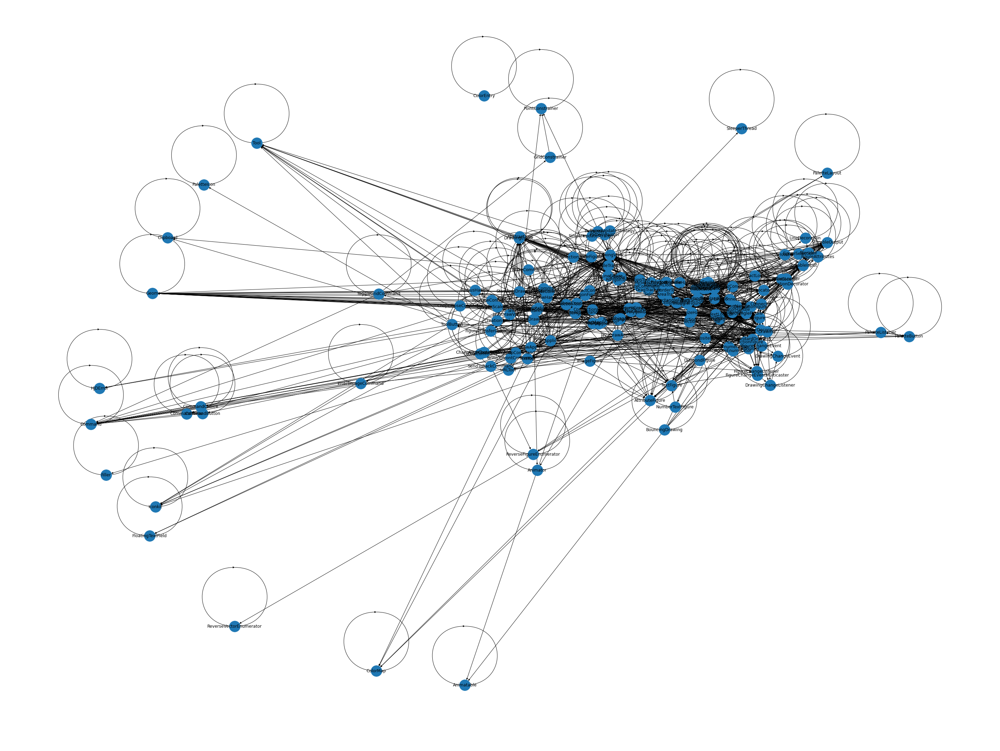

In [5]:
import matplotlib.pyplot as plt

plt.figure(0, figsize=(40,30))

nx.draw_spring(G, 
  labels=self_labels,
  node_size=1000,
)

### Attracting components

In [6]:
[[self_labels.get(member, member) for member in members] for members in list(nx.attracting_components(G))]

[['Storable', 'StorableOutput', 'StorableInput'],
 ['PointConstrainer'],
 ['Tool'],
 ['Geom'],
 ['ColorMap'],
 ['ReverseVectorEnumerator'],
 ['Filler'],
 ['FloatingTextField'],
 ['Iconkit'],
 ['Animatable'],
 ['HJDError'],
 ['PaletteListener', 'PaletteButton'],
 ['PaletteIcon'],
 ['Command'],
 ['PaletteLayout'],
 ['Clipboard'],
 ['SleeperThread'],
 ['ColorEntry']]

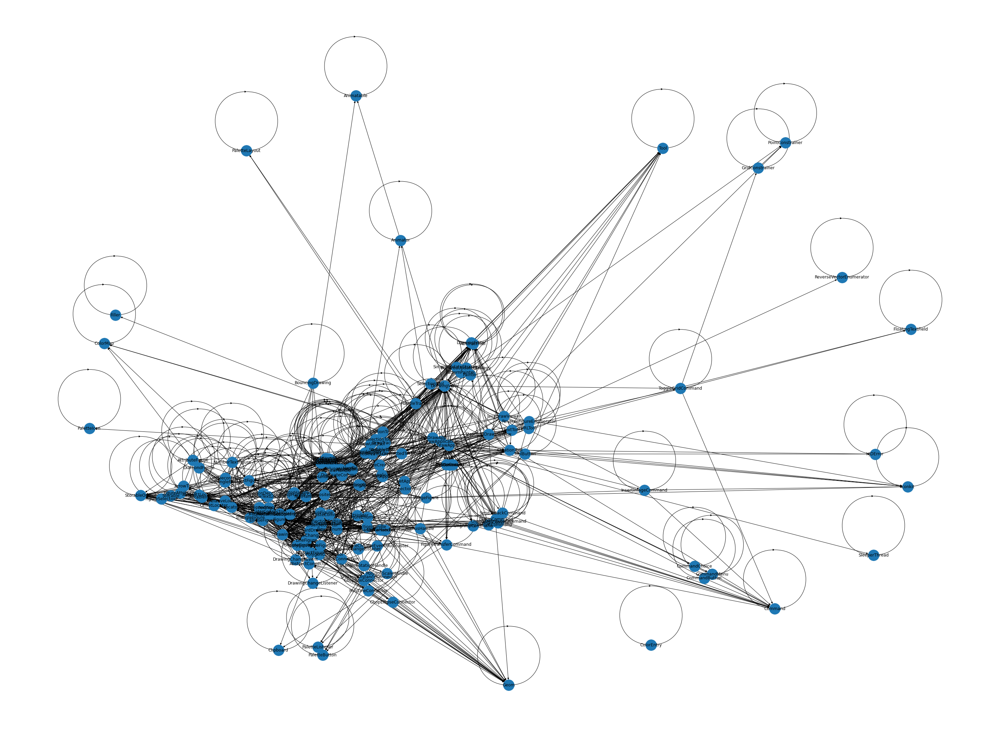

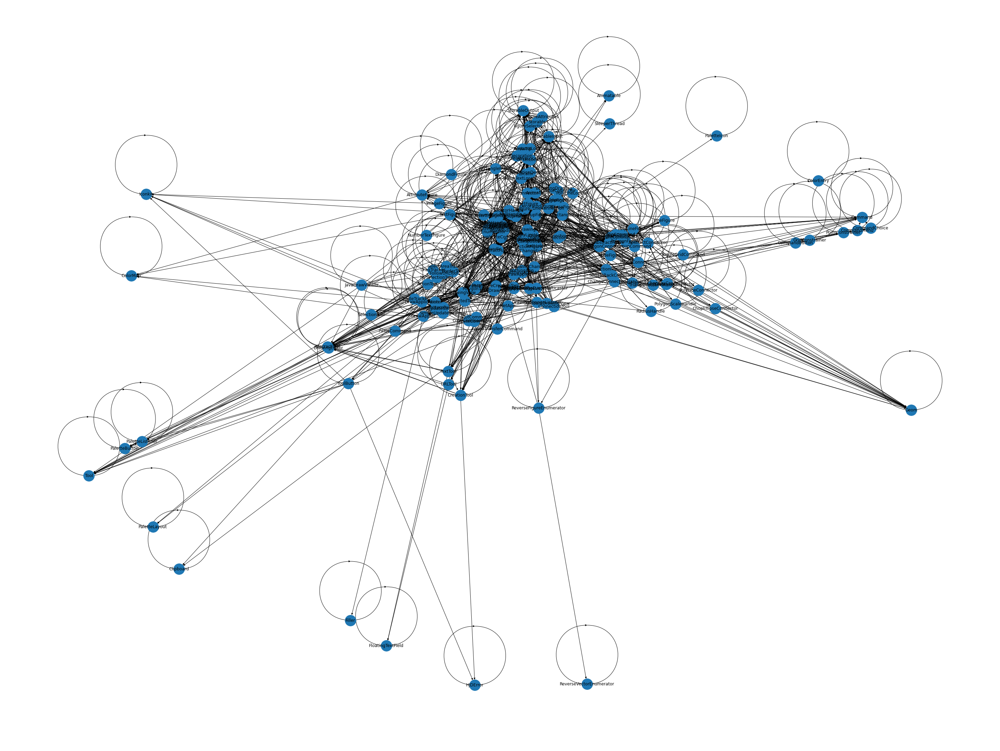

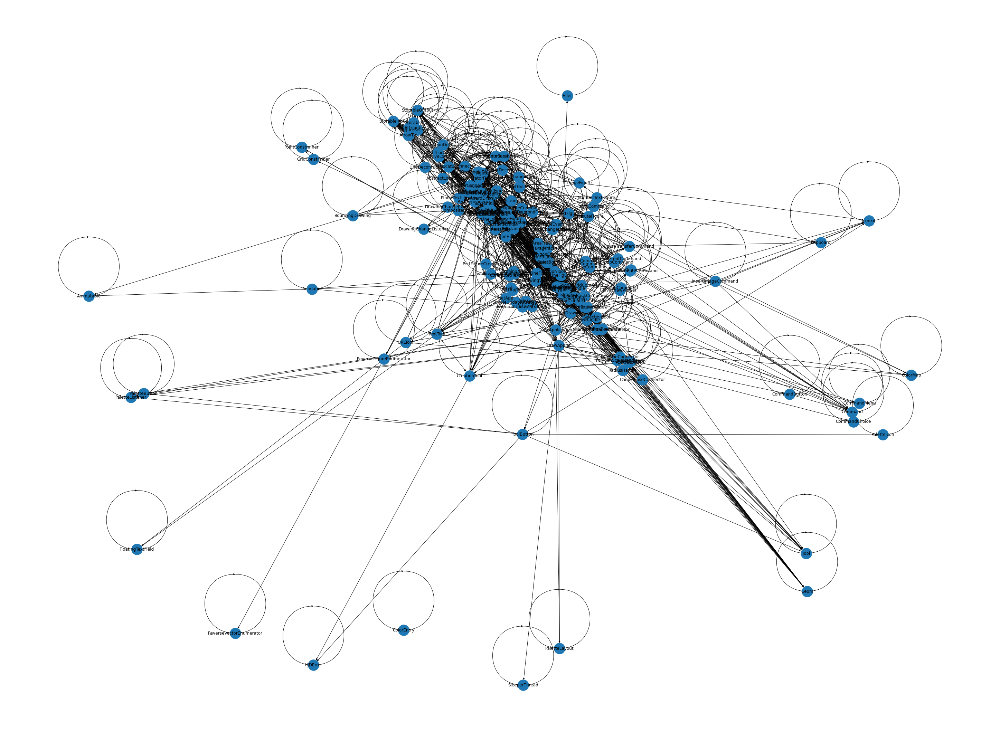

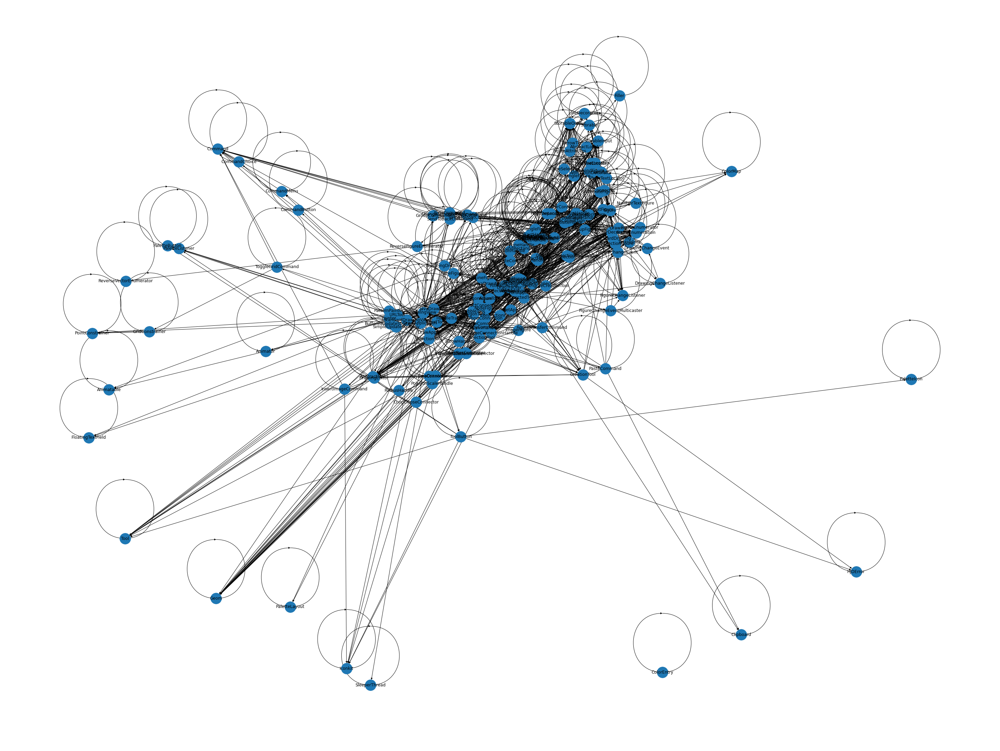

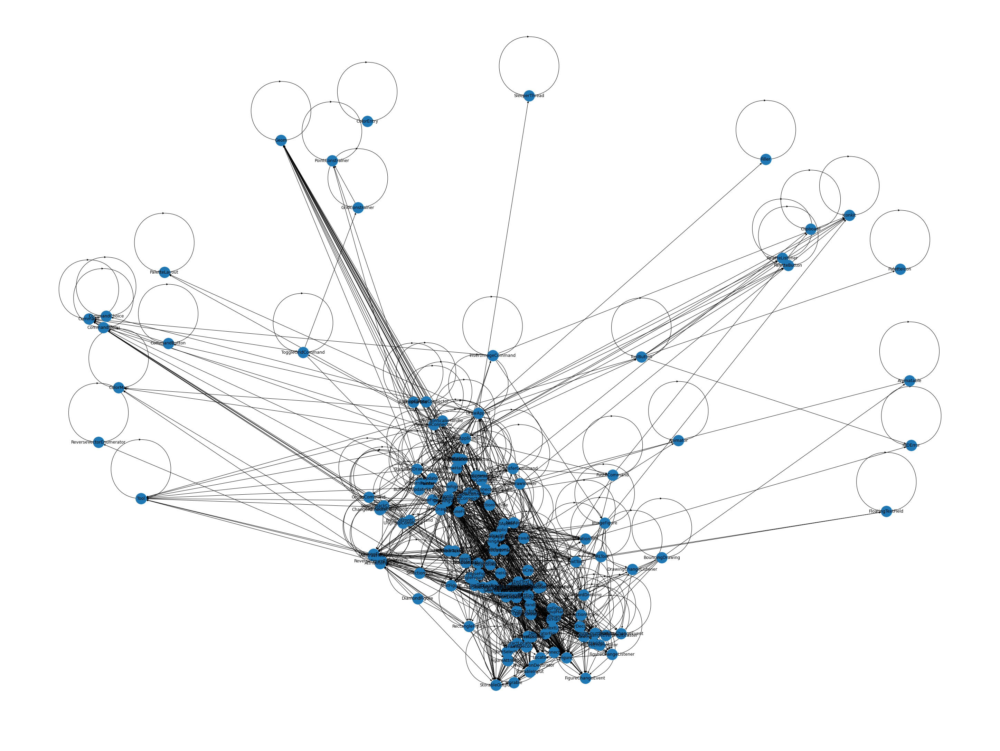

...

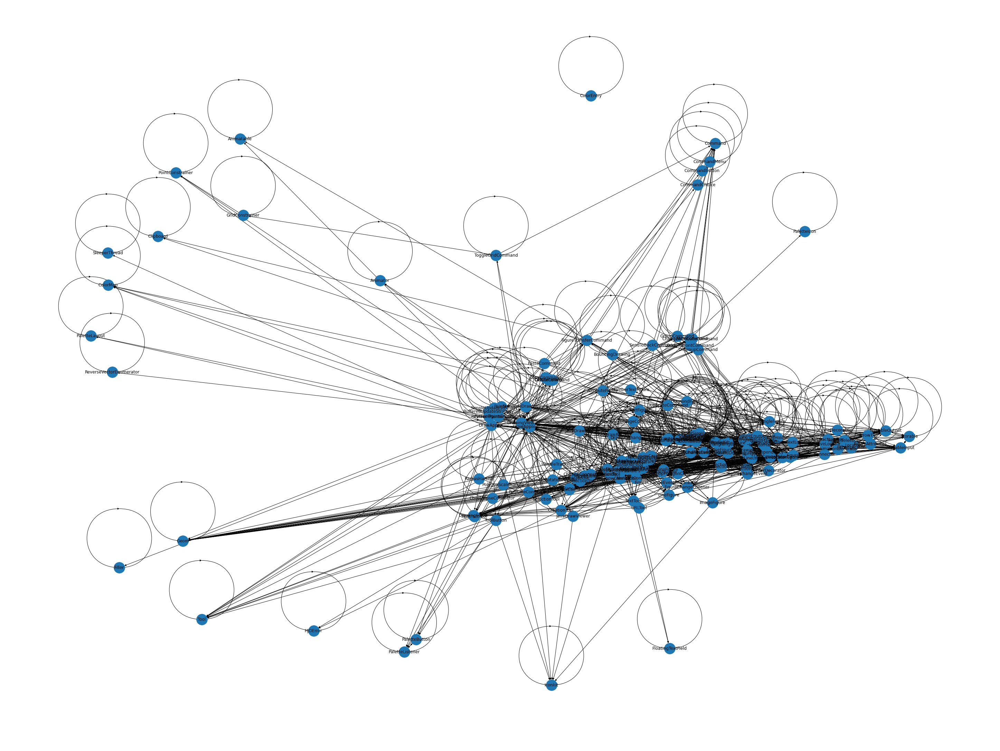

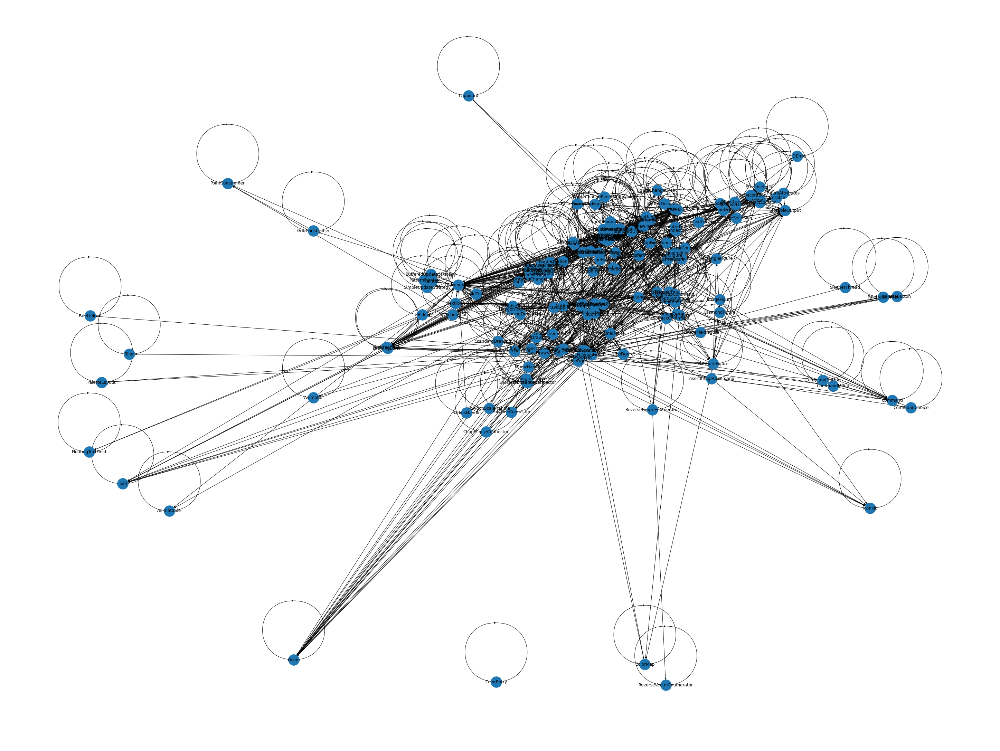

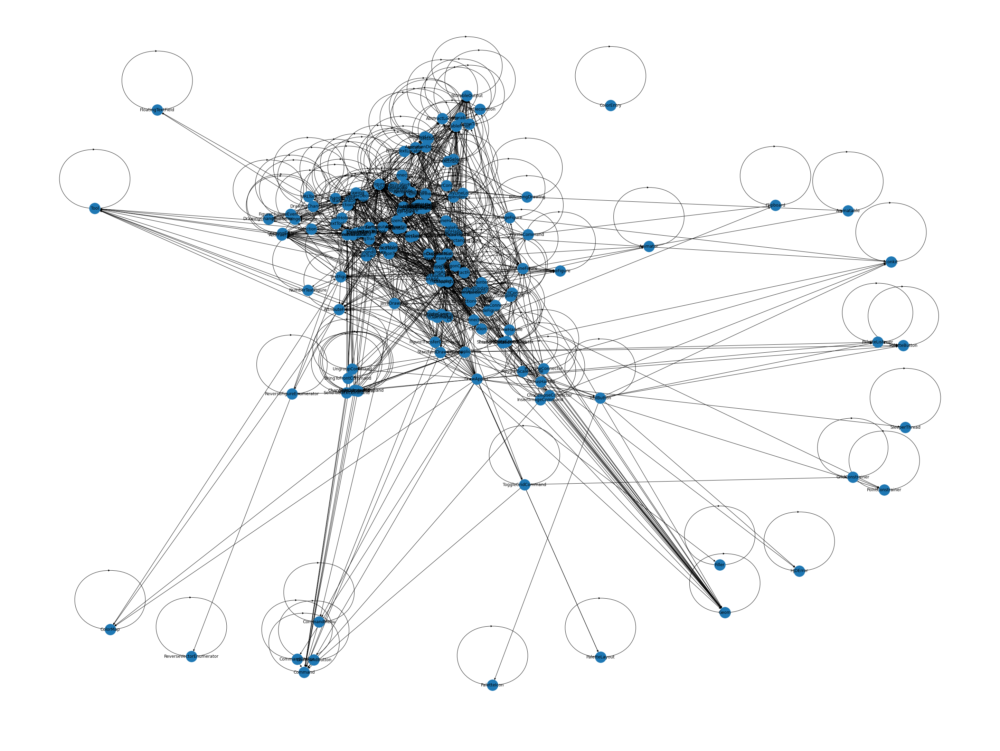

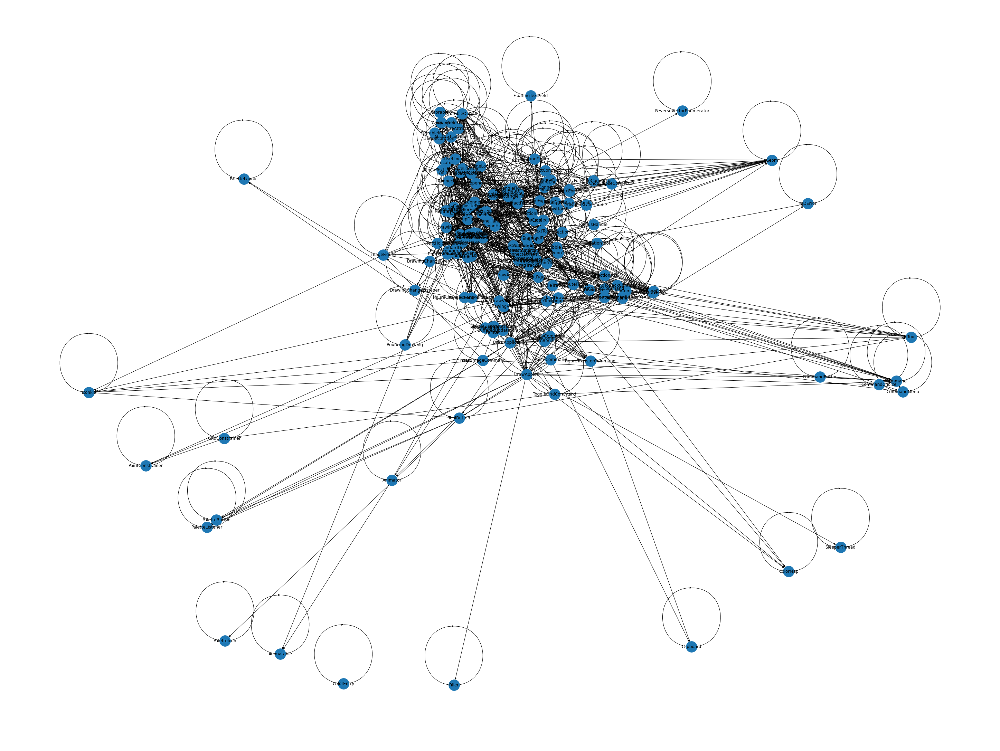

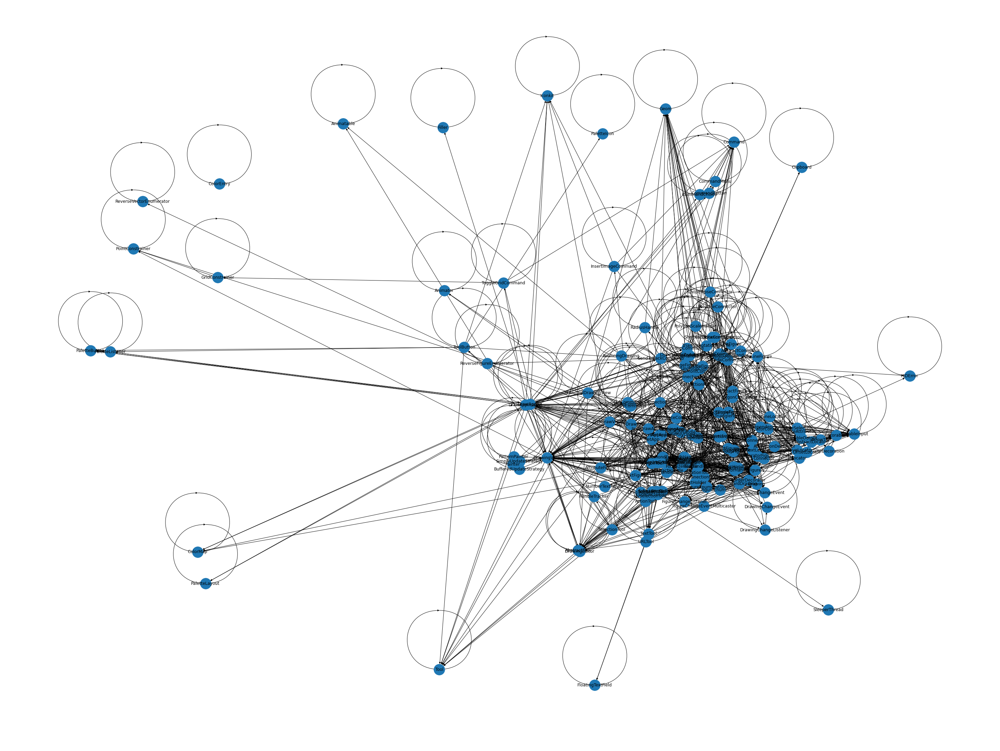

In [7]:
i = 1

for g in (G.subgraph(c).copy() for c in nx.attracting_components(G)):

  plt.figure(i, figsize=(40,30))

  nx.draw_spring(G, 
    labels=self_labels,
    node_size=1000,
  )

  i += 1

In [8]:
from networkx.algorithms import community


### Communities

#### Girvan-Newman

In [9]:
communities_generator = community.girvan_newman(G)
top_level_communities = next(communities_generator)
next_level_communities = next(communities_generator)
communities = sorted(map(sorted, next_level_communities))
[[self_labels.get(member, member) for member in members] for members in communities]

[['ChopPolygonConnector',
  'BufferedUpdateStrategy',
  'FigureChangeEventMulticaster',
  'CommandMenu',
  'ConnectionTool',
  'LocatorHandle',
  'StorableOutput',
  'ChangeAttributeCommand',
  'MySelectionTool',
  'DuplicateCommand',
  'AbstractHandle',
  'FigureSelection',
  'AttributeFigure',
  'PaletteButton',
  'GroupFigure',
  'Geom',
  'DrawApplication',
  'Clipboard',
  'PolyLineConnector',
  'AbstractConnector',
  'StorableInput',
  'FloatingTextField',
  'ShortestDistanceConnector',
  'TriangleFigure',
  'JavaDrawApplet',
  'PaletteListener',
  'SouthWestHandle',
  'TextFigure',
  'ChangeConnectionStartHandle',
  'RadiusHandle',
  'NetApp',
  'DeleteCommand',
  'CommandButton',
  'Connector',
  'PertDependency',
  'Locator',
  'Iconkit',
  'SelectAreaTracker',
  'FigureEnumerator',
  'EllipseFigure',
  'HandleTracker',
  'Storable',
  'Tool',
  'NothingApplet',
  'SimpleUpdateStrategy',
  'PertFigure',
  'ColorMap',
  'ElbowConnection',
  'ChangeConnectionHandle',
  'PatternP

#### Greedy Modularity

In [10]:
communities = community.greedy_modularity_communities(G)
[[self_labels.get(member, member) for member in members] for members in communities]

[['SleeperThread',
  'CutCommand',
  'InsertImageCommand',
  'CommandButton',
  'GroupCommand',
  'StandardDrawingView',
  'FigureEnumerator',
  'DrawingChangeEvent',
  'FigureTransferCommand',
  'Command',
  'BorderTool',
  'ScribbleTool',
  'DrawingEditor',
  'CommandMenu',
  'AbstractTool',
  'BufferedUpdateStrategy',
  'Iconkit',
  'GridConstrainer',
  'AlignCommand',
  'PaletteButton',
  'CommandChoice',
  'DrawingView',
  'Drawing',
  'MySelectionTool',
  'Painter',
  'JavaDrawViewer',
  'ToggleGridCommand',
  'DrawApplication',
  'PaletteIcon',
  'Handle',
  'DrawingChangeListener',
  'ChangeAttributeCommand',
  'SimpleUpdateStrategy',
  'ToolButton',
  'DragTracker',
  'PointConstrainer',
  'FollowURLTool',
  'CopyCommand',
  'BringToFrontCommand',
  'SelectAreaTracker',
  'DuplicateCommand',
  'SelectionTool',
  'PaletteLayout',
  'ActionTool',
  'StandardDrawing',
  'Tool',
  'FigureEnumeration',
  'SendToBackCommand',
  'UngroupCommand',
  'Filler',
  'DeleteCommand',
  'Han

### Condensation

In [11]:
cond = nx.condensation(G)
cond.number_of_nodes(), cond.number_of_edges()

(131, 572)

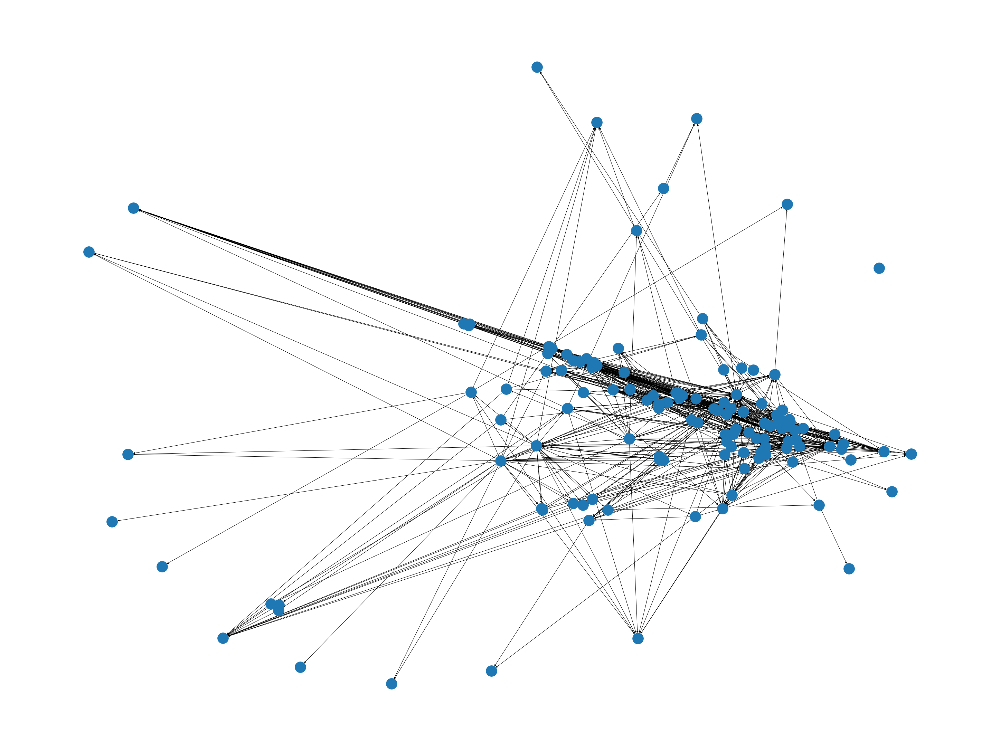

In [12]:
import matplotlib.pyplot as plt

plt.figure(1000, figsize=(40,30))

nx.draw_spring(cond, 
  node_size=1000,
)

In [13]:
members = nx.get_node_attributes(cond, 'members')
{ k:{self_labels.get(n, n) or n for n in nodes} for k,nodes in members.items() }

{0: {'Storable', 'StorableInput', 'StorableOutput'},
 1: {'ConnectionFigure',
  'Connector',
  'Figure',
  'FigureChangeEvent',
  'FigureChangeListener',
  'FigureEnumeration',
  'Locator'},
 2: {'AbstractLocator'},
 3: {'ElbowTextLocator'},
 4: {'PointConstrainer'},
 5: {'Drawing', 'DrawingChangeEvent', 'DrawingChangeListener'},
 6: {'Tool'},
 7: {'FigureSelection'},
 8: {'DrawingEditor', 'DrawingView', 'Handle', 'Painter'},
 9: {'AbstractHandle'},
 10: {'LineDecoration'},
 11: {'Geom'},
 12: {'AbstractConnector'},
 13: {'ChopBoxConnector'},
 14: {'RelativeLocator'},
 15: {'FigureEnumerator'},
 16: {'FigureChangeEventMulticaster'},
 17: {'AbstractFigure'},
 18: {'LocatorHandle'},
 19: {'ArrowTip'},
 20: {'PolyLineConnector',
  'PolyLineFigure',
  'PolyLineHandle',
  'PolyLineLocator'},
 21: {'ChangeConnectionHandle'},
 22: {'ChangeConnectionEndHandle'},
 23: {'ChangeConnectionStartHandle'},
 24: {'LineConnection'},
 25: {'ElbowHandle'},
 26: {'NullHandle'},
 27: {'TextHolder'},
 28: {

In [14]:
t = nx.minimum_spanning_tree(G)

plt.figure(1001, figsize=(40,30))

nx.draw_spring(t, 
  node_size=1000,
)

NetworkXNotImplemented: not implemented for directed type